# YOLOv5

## Student Information

**Student**: Anna Boronina

**Telegram**: @whoorma

## Introduction and navigation

This project trains YOLOv5 on a custom dataset with three classes that represent recycling codes: PAP (21, 22), PP (05) and ALU (41). The dataset can be found by following this [link](https://app.roboflow.com/ds/fsQlcIFycd?key=GrmU7nZN80). The dataset was generate with the following augmentations:
- Random rotation (from -45 to +45 degrees)
- Random hue (from -180 to +180 degrees)
- Random Brightness change (from -25% to 25%)
- Exposure (from -16% to +16%)
- Blur (up to 2.75px)
- Cutout (4 boxes with 10% of size each)

This notebook is based on the [official YOLOv5-tiny tutorial](https://blog.roboflow.com/how-to-train-yolov5-on-a-custom-dataset/) posted by Roboflow.

Please, read this section before proceeding any further.

1. **Install Dependencies**
    - This section installs all the necessary dependencies to run YOLOv5. The choice of dependencies is based on the requirements.txt file in [the official yolov5 repository](https://github.com/ultralytics/yolov5). Also, this section shows torch version (1.10.0+cu111) and CUDA properties.

2. **Download and Visualize the Dataset**
    - This section downloads the dataset via API key provided by Roboflow and makes sure all folders (_train/_, _valid/_, _test/_) were correctly downloaded.

3. **Define Model Configuration and Architecture**
    - This section modifies the configuration file for YOLOv5. The only changes are: number of classes will be 3 and number of epochs will be 2000.

4. **Train custom YOLOv5 detector**
    - This section trains YOLOv5 on the dataset downloaded in section 2. The configuration file stays the same except the number of epochs is changed to 4000

5. **Evaluate Custom YOLOv5 Detector Performance**
    - Compare ground truth labels 

6. **Run Inference With Best and Last Weights**
    - This section shows results of the model with the best and last weights of the training process

7. **Export Best and Last weights**
    - This section allows to copy necessary folders to google drive


**Important**: when checking results, make sure you chose correct folders: _runs/train/yolov5s_results[X]_ and _runs/detect/exp[X]_ where X is the number of your run

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


#Install Dependencies

In [2]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 10162, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 10162 (delta 0), reused 2 (delta 0), pack-reused 10159
Receiving objects: 100% (10162/10162), 10.45 MiB | 25.06 MiB/s, done.
Resolving deltas: 100% (7037/7037), done.
/content/yolov5


In [3]:
%pip install -qr requirements.txt  # install

from yolov5 import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v6.0-135-g922fbd8 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 42.0/166.8 GB disk)


# Download and Visualize the Dataset 

In [4]:
%cd /content/yolov5

!pip install -q roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="yBXjH8pcGQof5m0jEE6l")
project = rf.workspace().project("cvdl-a2-small-ey3rj")
dataset = project.version(3).download("yolov5")

/content/yolov5
     |████████████████████████████████| 145 kB 13.3 MB/s 
     |████████████████████████████████| 178 kB 61.0 MB/s 
     |████████████████████████████████| 1.1 MB 25.3 MB/s 
     |████████████████████████████████| 67 kB 5.2 MB/s 
     |████████████████████████████████| 138 kB 52.9 MB/s 
     |████████████████████████████████| 62 kB 771 kB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to CVDL-A2-small-3 in yolov5pytorch:: 100%|██████████| 340/340 [00:01<00:00, 229.32it/s]


In [5]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- ALU
- PAP
- POL
nc: 3
train: CVDL-A2-small-3/train/images
val: CVDL-A2-small-3/valid/images


In [6]:
# to make sure all folders (train, valid, test) are present
!ls /content/yolov5/CVDL-A2-small-3/

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


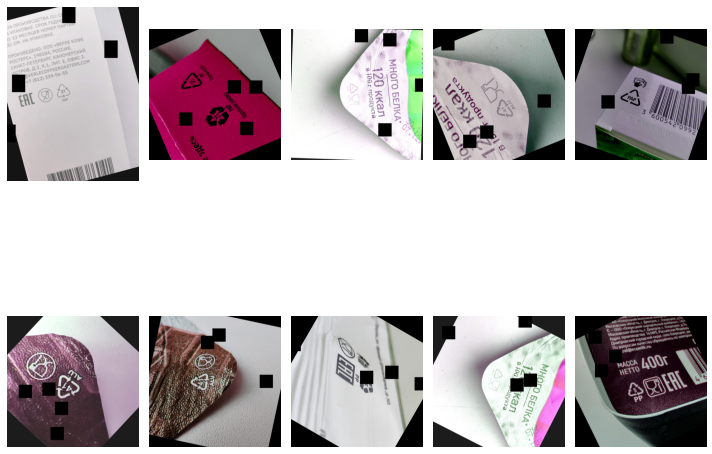

In [7]:
import os
import random
import cv2
import matplotlib.pyplot as plt


def show_in_rows(list_of_images, cols=5, figsize=(20,20)):
    samples = len(list_of_images)
    # plt.figure(figsize=figsize)
    rows = samples // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=figsize)
    for i in range(samples):
        image = list_of_images[i]
        cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
        ax.ravel()[i].imshow(image, cmap=cmap)
        ax.ravel()[i].set_axis_off()
    plt.tight_layout()
    plt.show()

train_images = [f for f in os.listdir('/content/yolov5/CVDL-A2-small-3/train/images') if f.endswith('.jpg')]
images_to_show = []
for _ in range(10):
    img_path = f"/content/yolov5/CVDL-A2-small-3/train/images/{random.choice(train_images)}"
    img = cv2.imread(img_path)
    images_to_show.append(img)

show_in_rows(images_to_show, cols=5, figsize=(10, 10))

In [8]:
img_path = f"/content/yolov5/CVDL-A2-small-3/train/images/{random.choice(train_images)}"
cv2.imread(img_path).shape

(2048, 2048, 3)

# Define Model Configuration and Architecture

Creating a .yaml script that defines the parameters for the model. E.g., the number of classes, anchors, and each layer.

In this dataset we have 3 classes: PAP, POL, ALU.

In [9]:
# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    # in my case num_classes == 3
    num_classes = str(yaml.safe_load(stream)['nc'])

In [10]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [11]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train YOLOv5 **without** any initial weights

## Train Custom YOLOv5 Detector

In [12]:
# train yolov5s on custom data for 5000 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 700 --batch 64 --epochs 5000 --patience 0 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

Streaming output truncated to the last 5000 lines.
                 all         20         30      0.823      0.377      0.426      0.177

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  422/4999     15.4G   0.02811   0.01555   0.01563         1       704: 100% 3/3 [00:03<00:00,  1.15s/it]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 1/1 [00:00<00:00,  2.56it/s]
                 all         20         30      0.852      0.386      0.452      0.167

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  423/4999     15.4G   0.03376   0.01541  0.002418         4       704: 100% 3/3 [00:03<00:00,  1.16s/it]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 1/1 [00:00<00:00,  3.11it/s]
                 all         20         30      0.654      0.419      0.512      0.206

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  424/4999     1

## Run Inference  with Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [13]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [14]:
import os
import random
import cv2
import matplotlib.pyplot as plt

def show_in_rows(list_of_images, cols=5):
    samples = len(list_of_images)
    # plt.figure(figsize=figsize)
    rows = samples // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(20, 20))
    for i in range(samples):
        image = list_of_images[i]
        cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
        ax.ravel()[i].imshow(image, cmap=cmap)
        ax.ravel()[i].set_axis_off()
    plt.tight_layout()
    plt.show()

### Best Weights

In [15]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 700 --conf 0.6 --source CVDL-A2-small-3/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=CVDL-A2-small-3/test/images, imgsz=[700, 700], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-135-g922fbd8 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 232 layers, 7251912 parameters, 0 gradients, 16.8 GFLOPs
image 1/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140106_jpg.rf.299db4a1977d6d5176556a1f5d11208e.jpg: 704x704 Done. (0.012s)
image 2/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140214_jpg.rf.ea2532adcec1fb3dfba966e1feb5255b.jpg: 704x704 Done. (0.016s)
image 3/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_202111

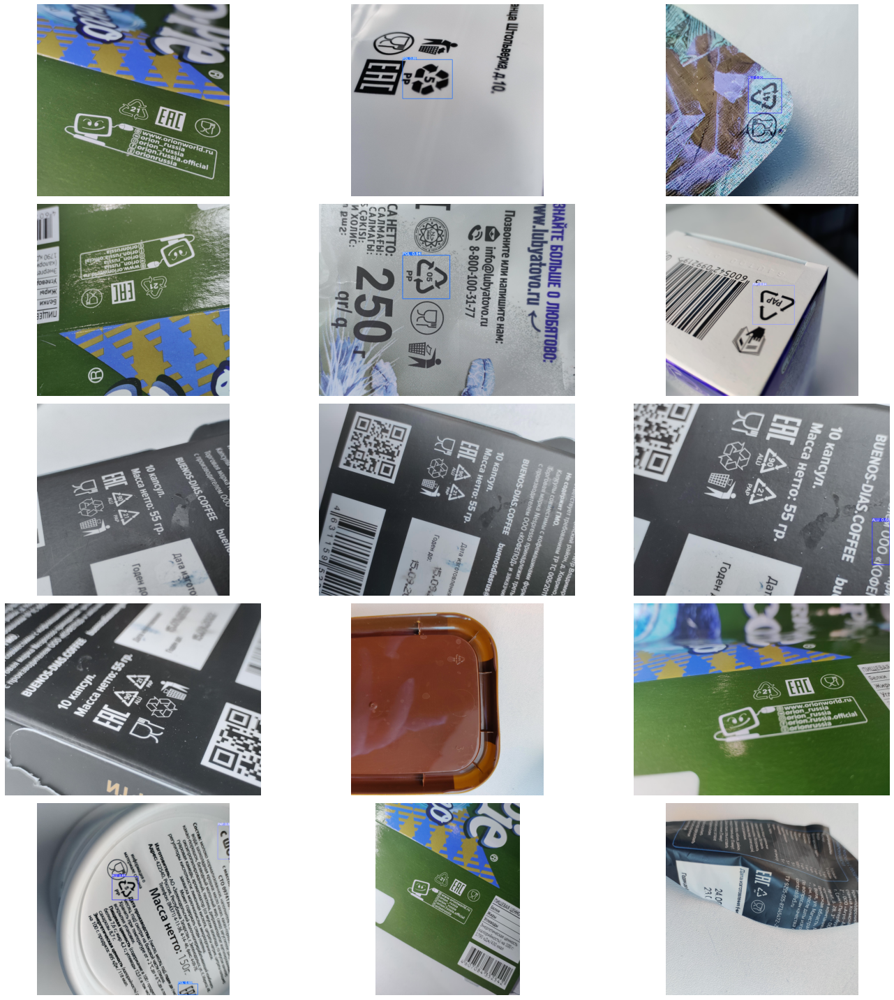

In [16]:
test_images = [f for f in os.listdir('/content/yolov5/runs/detect/exp/') if f.endswith('.jpg')]
images_to_show = []
for i in range(len(test_images)):
    img_path = f"//content/yolov5/runs/detect/exp/{test_images[i]}"
    img = cv2.imread(img_path)
    images_to_show.append(img)

show_in_rows(images_to_show, cols=3)

### Last weights

In [17]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/last.pt --img 700 --conf 0.6 --source CVDL-A2-small-3/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/last.pt'], source=CVDL-A2-small-3/test/images, imgsz=[700, 700], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-135-g922fbd8 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 232 layers, 7251912 parameters, 0 gradients, 16.8 GFLOPs
image 1/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140106_jpg.rf.299db4a1977d6d5176556a1f5d11208e.jpg: 704x704 Done. (0.013s)
image 2/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140214_jpg.rf.ea2532adcec1fb3dfba966e1feb5255b.jpg: 704x704 Done. (0.013s)
image 3/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_202111

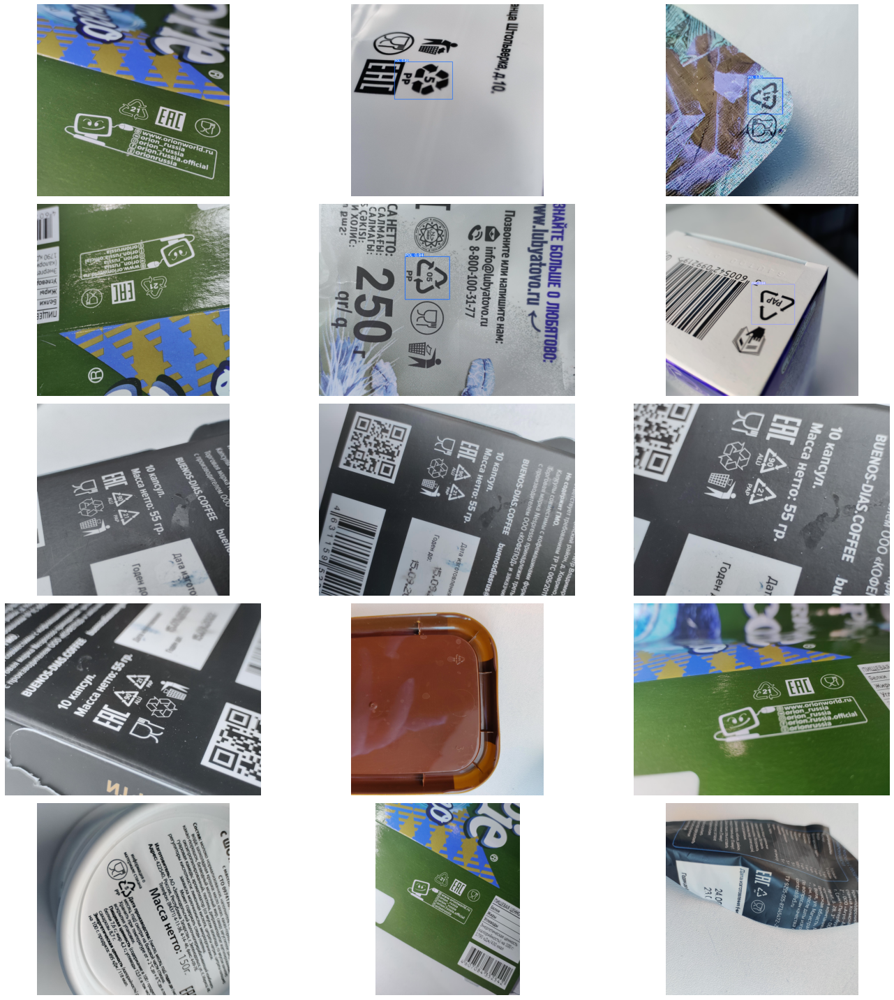

In [18]:
test_images = [f for f in os.listdir('/content/yolov5/runs/detect/exp2/') if f.endswith('.jpg')]
images_to_show = []
for i in range(len(test_images)):
    img_path = f"/content/yolov5/runs/detect/exp2/{test_images[i]}"
    img = cv2.imread(img_path)
    images_to_show.append(img)

show_in_rows(images_to_show, cols=3)

# Train YOLOv5 **with** initial weights

## Train Custom YOLOv5 Detector

Since I ran this one during another runtime, its results were also saved to runs/. If you ran it within the same runtime as the training above, please check that there is runs2/ folder or runs/train/yolov5s_resultsX, where X is the number of your run

In [19]:
# train yolov5s on custom data for 5000 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 700 --batch 64 --epochs 5000 --patience 0 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights yolov5s.pt --name yolov5s_results2  --cache

Streaming output truncated to the last 5000 lines.
                 all         20         30      0.844      0.434      0.442      0.208

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  764/4999     15.4G   0.02268  0.008757  0.001271         2       704: 100% 3/3 [00:03<00:00,  1.15s/it]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 1/1 [00:00<00:00,  3.19it/s]
                 all         20         30      0.781      0.439      0.445      0.233

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  765/4999     15.4G   0.02404   0.01509  0.001699         1       704: 100% 3/3 [00:03<00:00,  1.15s/it]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 1/1 [00:00<00:00,  3.17it/s]
                 all         20         30      0.775      0.442      0.434      0.235

     Epoch   gpu_mem       box       obj       cls    labels  img_size
  766/4999     1

## Run Inference  with Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [20]:
%ls runs/train/yolov5s_results2/weights

best.pt  last.pt


In [21]:
# trained weights are saved by default in our weights folder
%ls runs/

detect/  train/


In [22]:
import os
import random
import cv2
import matplotlib.pyplot as plt

def show_in_rows(list_of_images, cols=5):
    samples = len(list_of_images)
    # plt.figure(figsize=figsize)
    rows = samples // cols
    figure, ax = plt.subplots(nrows=rows, ncols=cols, figsize=(20, 20))
    for i in range(samples):
        image = list_of_images[i]
        cmap = 'gray' if (len(img.shape) == 2 or img.shape[2] == 1) else None
        ax.ravel()[i].imshow(image, cmap=cmap)
        ax.ravel()[i].set_axis_off()
    plt.tight_layout()
    plt.show()

### Best Weights

In [23]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results2/weights/best.pt --img 700 --conf 0.6 --source CVDL-A2-small-3/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results2/weights/best.pt'], source=CVDL-A2-small-3/test/images, imgsz=[700, 700], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-135-g922fbd8 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 232 layers, 7251912 parameters, 0 gradients, 16.8 GFLOPs
image 1/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140106_jpg.rf.299db4a1977d6d5176556a1f5d11208e.jpg: 704x704 1 POL, Done. (0.013s)
image 2/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140214_jpg.rf.ea2532adcec1fb3dfba966e1feb5255b.jpg: 704x704 Done. (0.012s)
image 3/15 /content/yolov5/CVDL-A2-small-3/test/images/IM

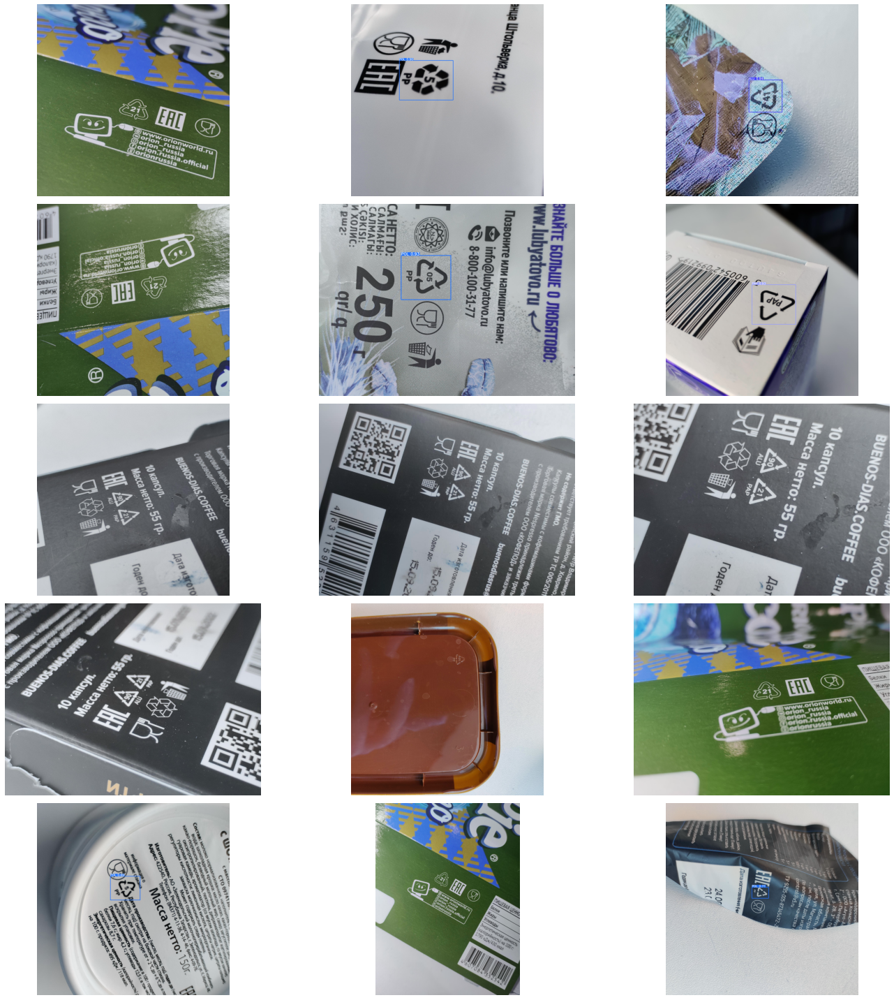

In [24]:
test_images = [f for f in os.listdir('/content/yolov5/runs/detect/exp3/') if f.endswith('.jpg')]
images_to_show = []
for i in range(len(test_images)):
    img_path = f"/content/yolov5/runs/detect/exp3/{test_images[i]}"
    img = cv2.imread(img_path)
    images_to_show.append(img)

show_in_rows(images_to_show, cols=3)

### Last weights

In [25]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results2/weights/last.pt --img 700 --conf 0.6 --source CVDL-A2-small-3/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results2/weights/last.pt'], source=CVDL-A2-small-3/test/images, imgsz=[700, 700], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.0-135-g922fbd8 torch 1.10.0+cu111 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model Summary: 232 layers, 7251912 parameters, 0 gradients, 16.8 GFLOPs
image 1/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140106_jpg.rf.299db4a1977d6d5176556a1f5d11208e.jpg: 704x704 Done. (0.013s)
image 2/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211115_140214_jpg.rf.ea2532adcec1fb3dfba966e1feb5255b.jpg: 704x704 Done. (0.013s)
image 3/15 /content/yolov5/CVDL-A2-small-3/test/images/IMG_20211

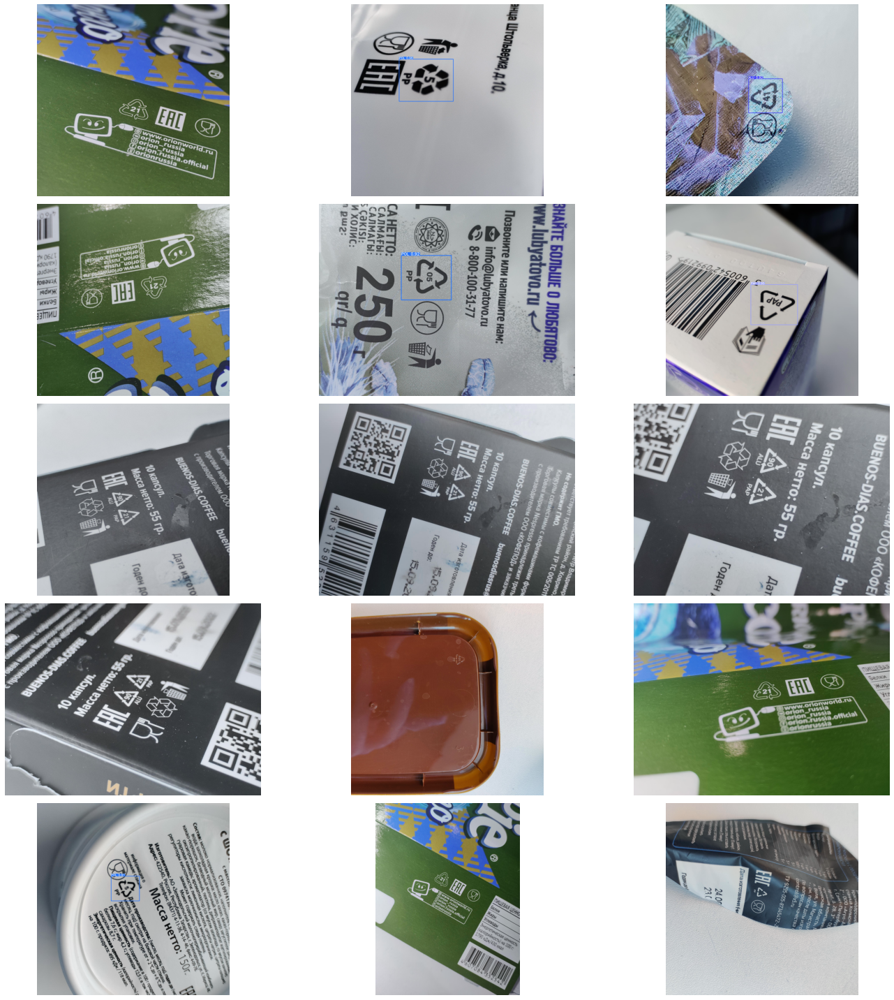

In [26]:
test_images = [f for f in os.listdir('/content/yolov5/runs/detect/exp4/') if f.endswith('.jpg')]
images_to_show = []
for i in range(len(test_images)):
    img_path = f"/content/yolov5/runs/detect/exp4/{test_images[i]}"
    img = cv2.imread(img_path)
    images_to_show.append(img)

show_in_rows(images_to_show, cols=3)

# Export Everything

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [27]:
%cp -r /content/yolov5/runs/ /content/gdrive/My\ Drive

# Tensorboard

In [28]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>